In [1]:
from AnalysisEngine.analysis_engine.statistics.spectra import per_spectra, arevalo_spectra, flatsky_spectra, spectra_base
from astropy.io import fits
from regions import Regions
import pyregion
import pymaster as nmt
import numpy as np

import os

import matplotlib as mpl
import matplotlib.pyplot as plt
mpl.rcParams['figure.dpi'] = 250
from matplotlib.colors import LogNorm, Normalize
import cmasher as cmr

from scipy.signal import windows

from AnalysisEngine.analysis_engine.utils import plotting
from AnalysisEngine.analysis_engine.statistics.statfunc import corr, statfunc_base
from AnalysisEngine.analysis_engine.statistics import statistics_base
from AnalysisEngine.analysis_engine.statistics.spectra import arevalo_spectra, spectra_base, per_spectra
#from AnalysisEngine.analysis_engine.noise import noise_base, churazov
#from AnalysisEngine.analysis_engine.utils.noise_mape_mse import mape, mse

import astropy.units as u
#from astropy.cosmology import Planck18 as cosmo
from astropy.cosmology import WMAP1 as cosmo

inferno_cmap = plotting.make_bad_cmap('inferno')
bwr_cmap = plotting.make_bad_cmap('seismic')

DATA_DIR = 'ICM_old/Data/'
SZ_DATA = DATA_DIR

COMA_REDSHIFT = 0.0231
d_A = cosmo.angular_diameter_distance(z=COMA_REDSHIFT)

import pickle
inputsfirst = pickle.load(open('inputsfirst.p', 'rb'))
inputslast = pickle.load(open('inputslast.p', 'rb'))

khatrix, khatriy, khatrierror = (0.000461089,0.00056334,0.000717526,0.000974452,0.001333839,0.001846432),\
                                (2.89673913,3.336956522,3.798913043,4.027173913,3.586956522,2.934782609),\
                                [[0.380434783,0.434782609,0.505434783,0.586956522,0.679347826,0.657608696],
                                 [0.380434783,0.440217391,0.505434783,0.592391304,0.684782609,0.663043478]]
khatriy = [y/(1e6) for y in khatriy]
khatrierror[0] = [y/(1e6) for y in khatrierror[0]]
khatrierror[1] = [y/(1e6) for y in khatrierror[1]]
khatrixk = khatrix
khatrix = [2.*np.pi*q for q in khatrix]


6547.014042218403 kpc 46.76438601584574 kpc/pixel
e1	3.242620537551497e-06	42.638	96.338
g2	1.281793158510056e-06	16.855	97.587
g4	1.7435837153189304e-06	22.927	92.651
g6	2.297719444095891e-06	30.214	86.976
g8	2.8543585985518548e-06	37.533	81.271
g10	3.369370275075791e-06	44.305	75.868
g15	4.403175652318253e-06	57.899	64.231
g20	5.1281526760032816e-06	67.432	55.058
w_db3_4_0.10	1.2320987468723005e-06	16.201	99.938
w_db3_4_0.20	1.452785933875988e-06	19.103	99.37
w_db3_4_0.30	1.621410741970661e-06	21.321	98.922
w_db3_4_0.40	1.6525137168284976e-06	21.73	98.76
w_db3_4_0.50	1.7232894940883723e-06	22.66	98.575
w_db3_4_0.60	1.7452367346543042e-06	22.949	98.504
w_db3_4_0.70	1.754343529600091e-06	23.069	98.472
w_db3_4_0.80	1.8171151898393085e-06	23.894	98.223
w_db3_4_0.90	1.817138190161037e-06	23.894	98.223
w_db3_1_0.40	1.1495433129669745e-06	15.116	100.126
w_db3_2_0.40	1.189719949348178e-06	15.644	100.037
w_db3_3_0.40	1.4227239083595052e-06	18.708	99.519
w_haar_4_0.40	2.1106282777829017e-06	27

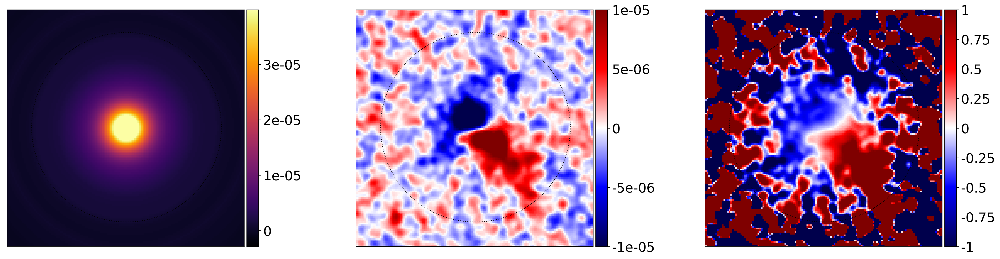

g2


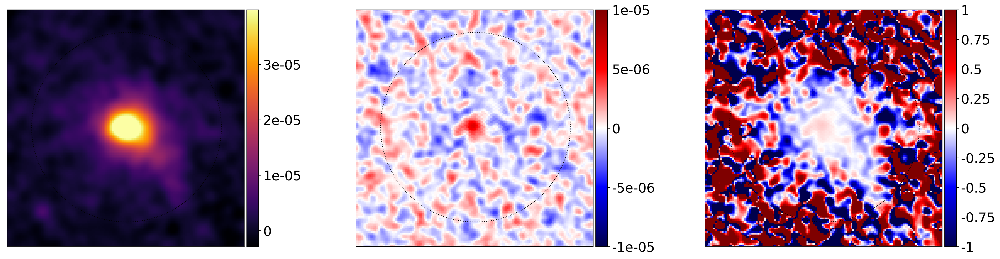

g4


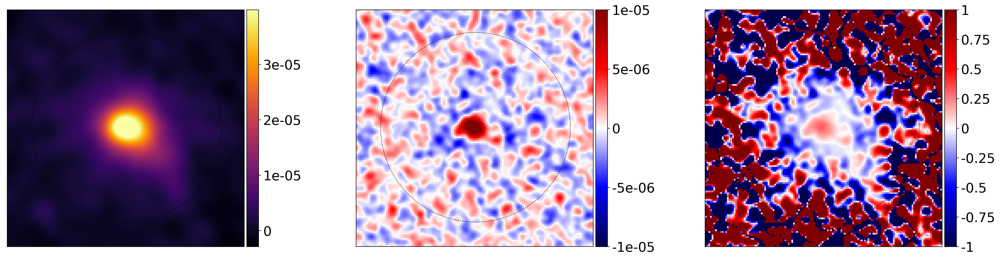

g6


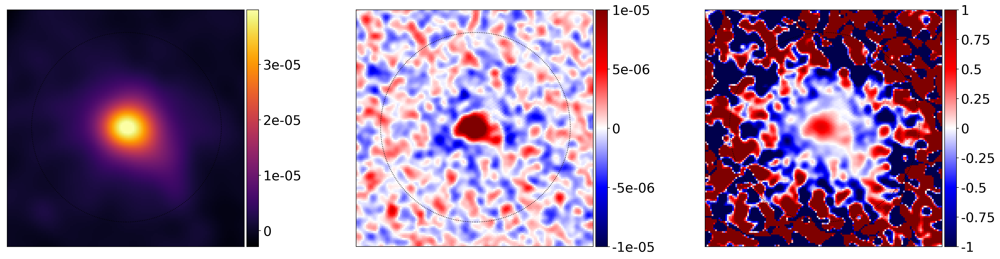

g8


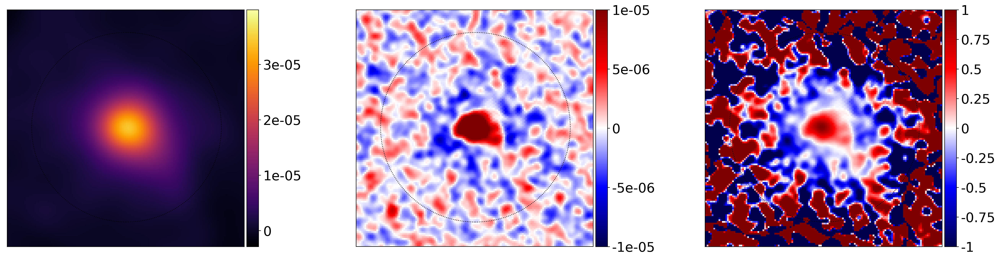

g10


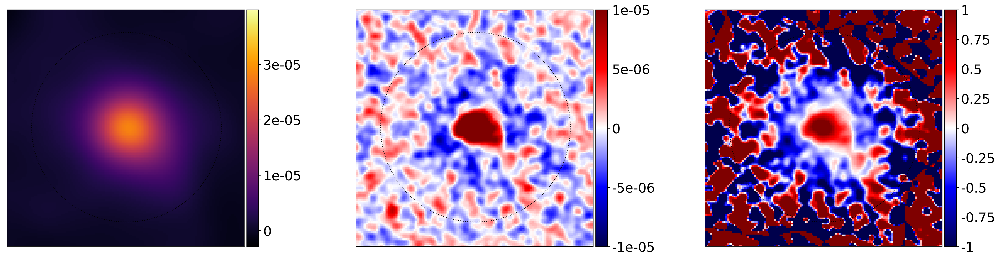

g15


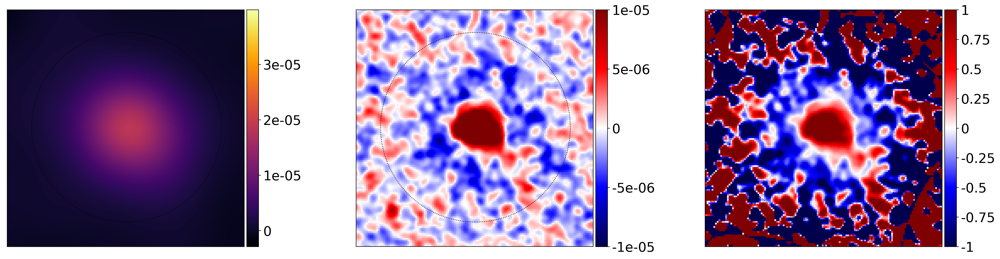

g20


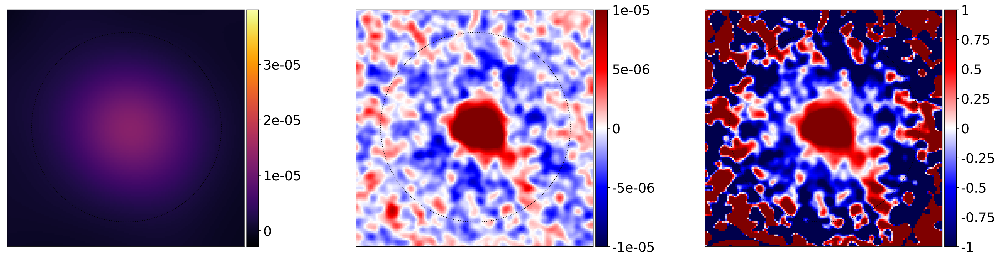

w_db3_4_0.10


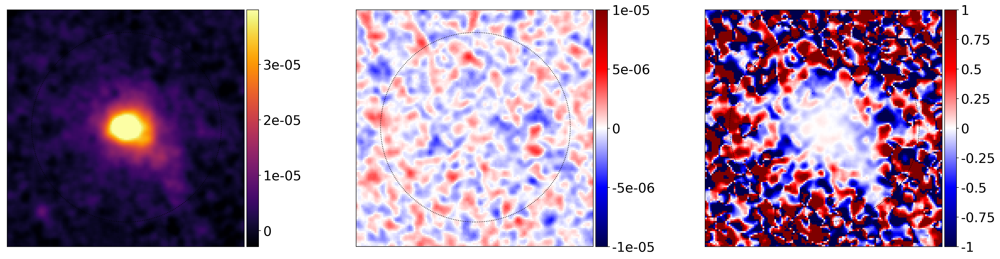

w_db3_4_0.20


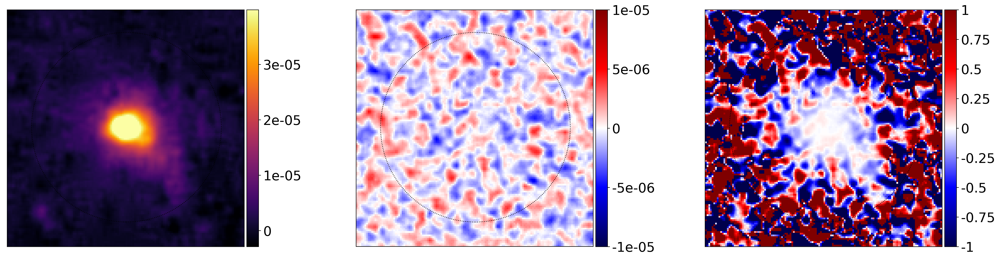

w_db3_4_0.30


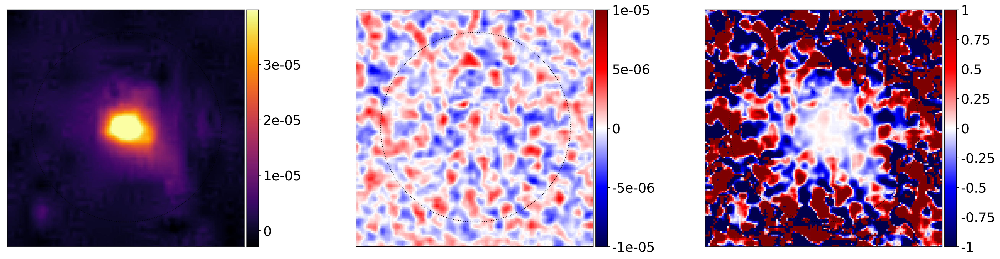

w_db3_4_0.40


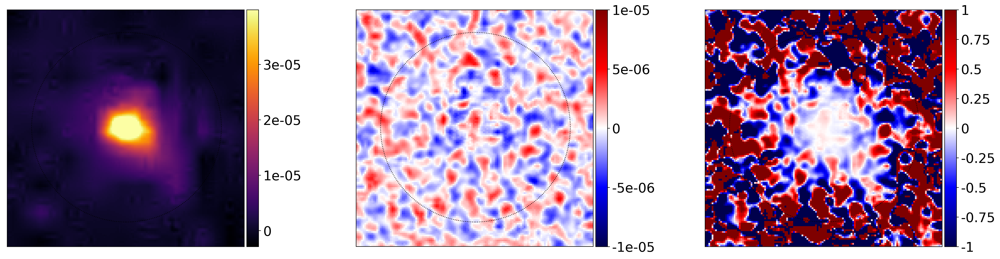

w_db3_4_0.50


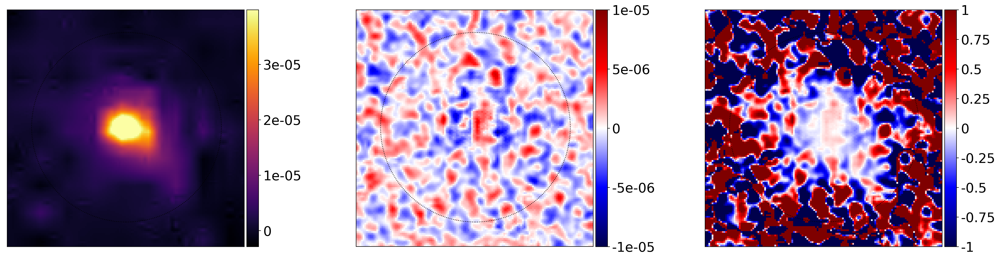

w_db3_4_0.60


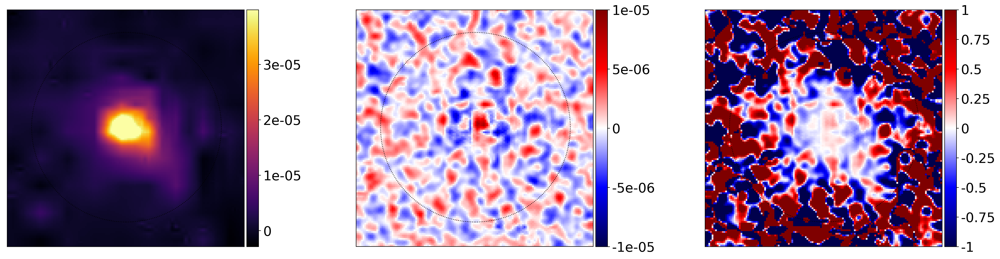

w_db3_4_0.70


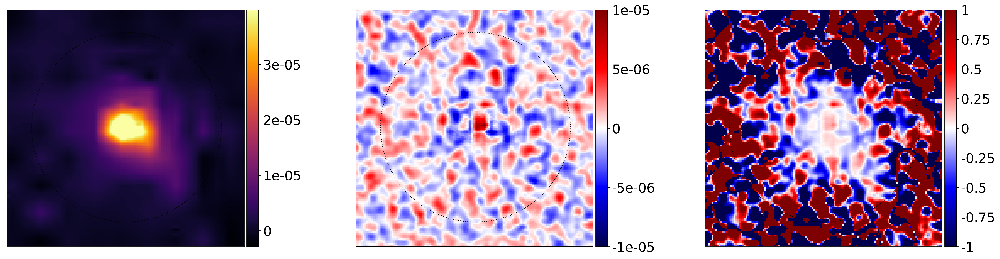

w_db3_4_0.80


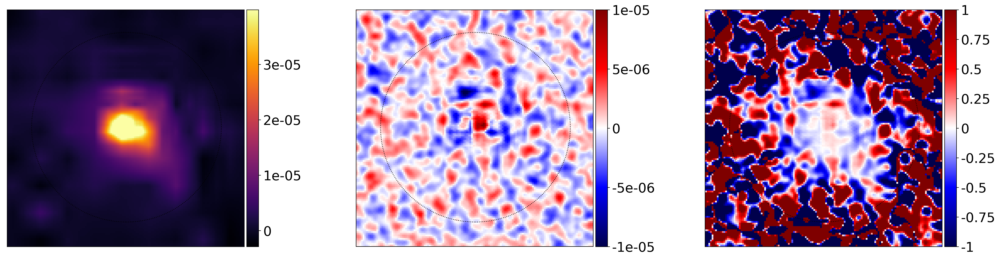

w_db3_4_0.90


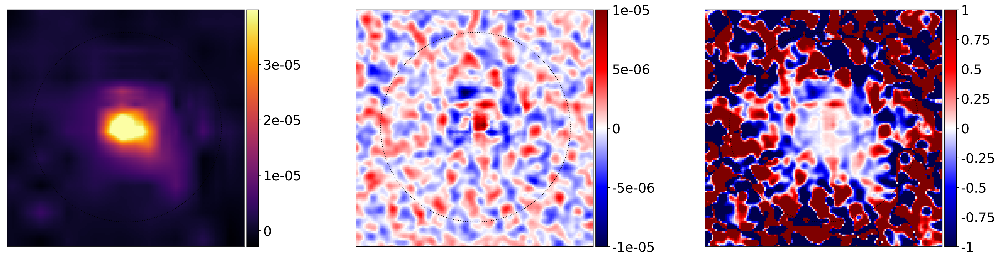

w_db3_1_0.40


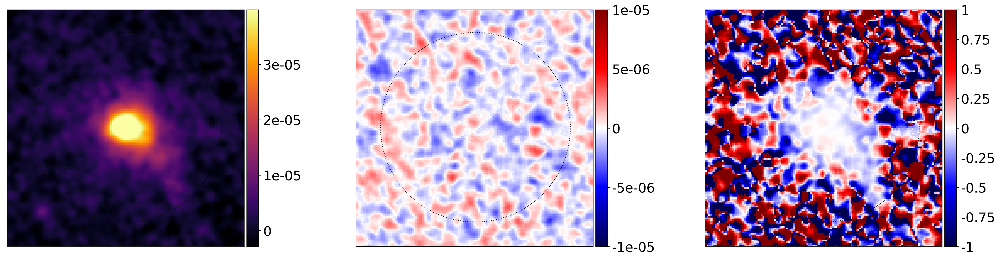

w_db3_2_0.40


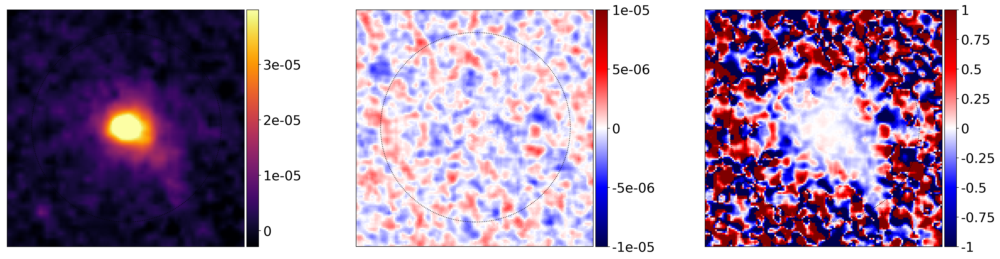

w_db3_3_0.40


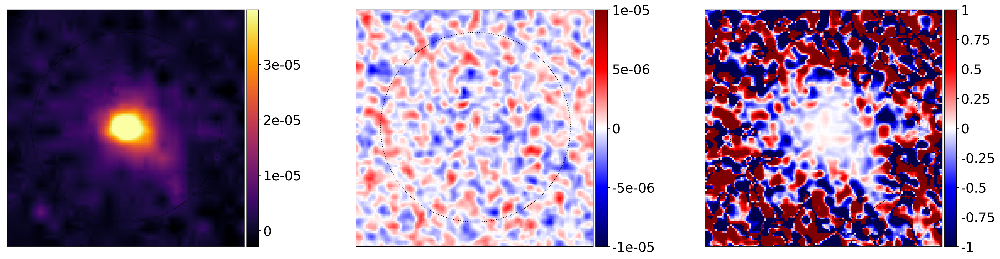

w_haar_4_0.40


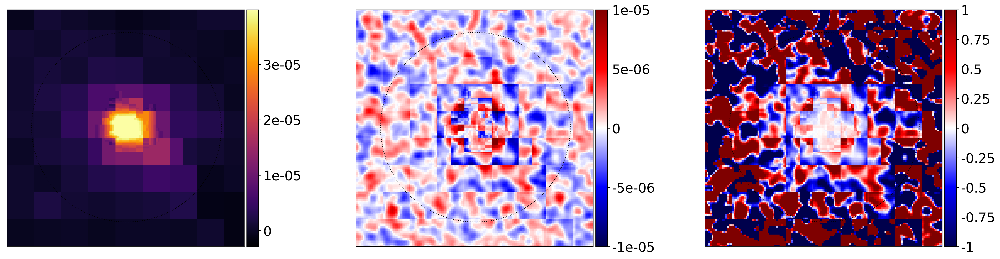

w_dmey_4_0.40


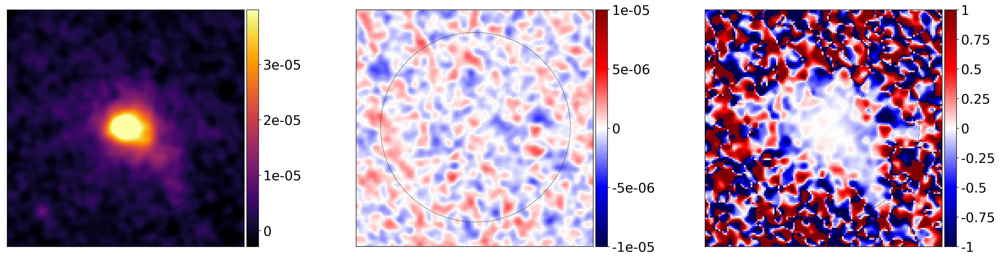

w_sym2_4_0.40


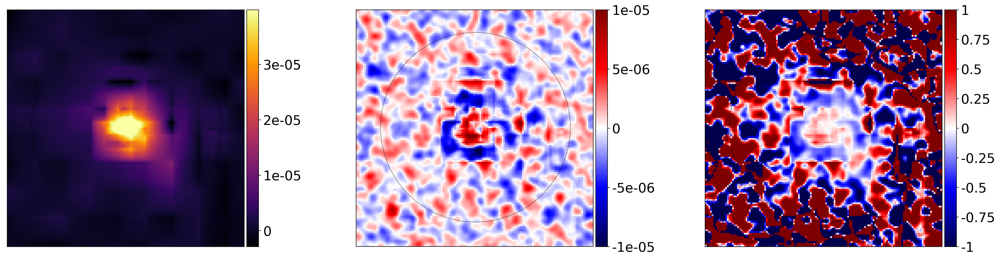

w_coif1_4_0.40


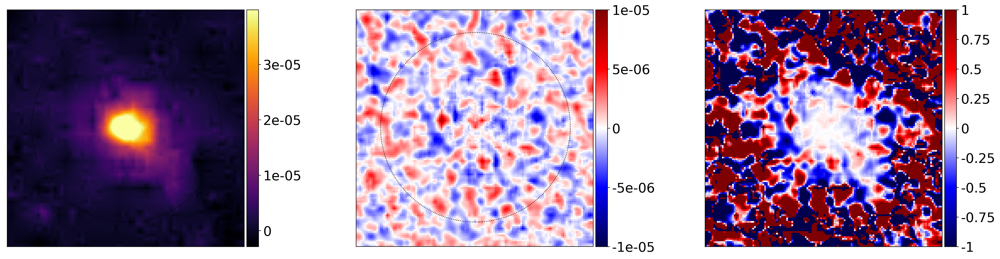

packet_db3_4_0.10


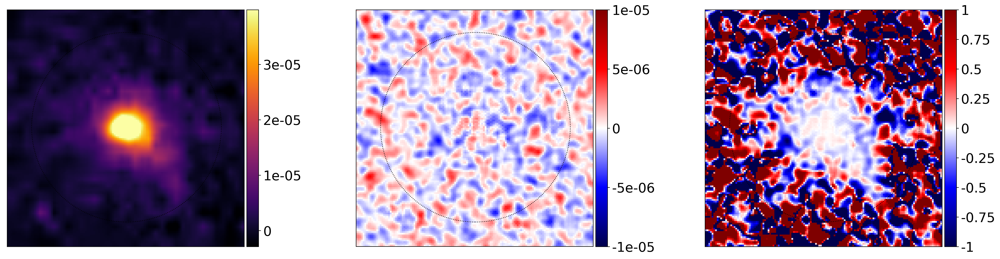

packet_db3_4_0.20


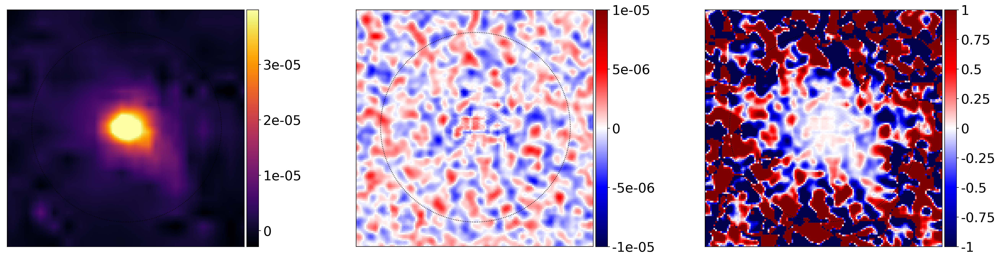

packet_db3_4_0.30


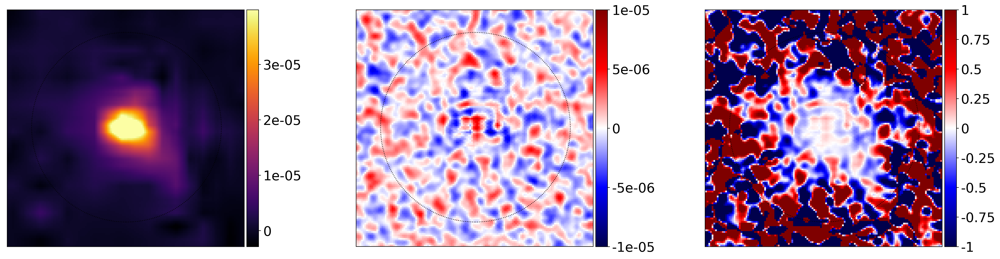

packet_db3_4_0.40


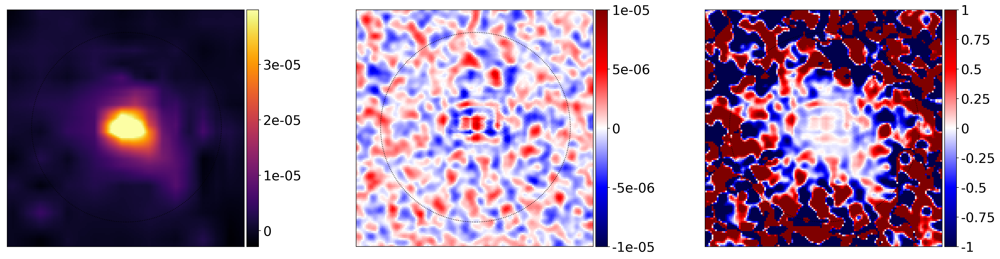

packet_db3_4_0.50


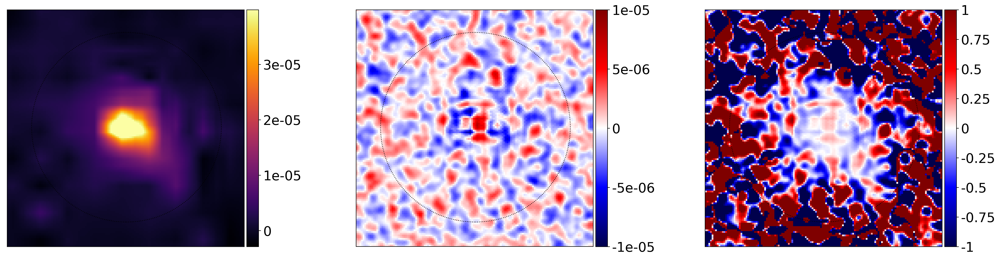

packet_db3_4_0.60


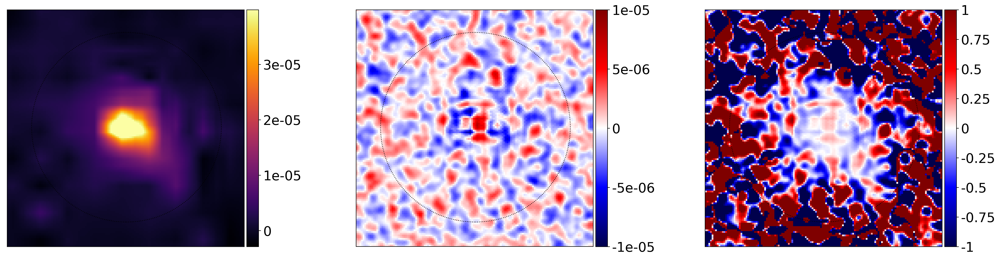

packet_db3_4_0.70


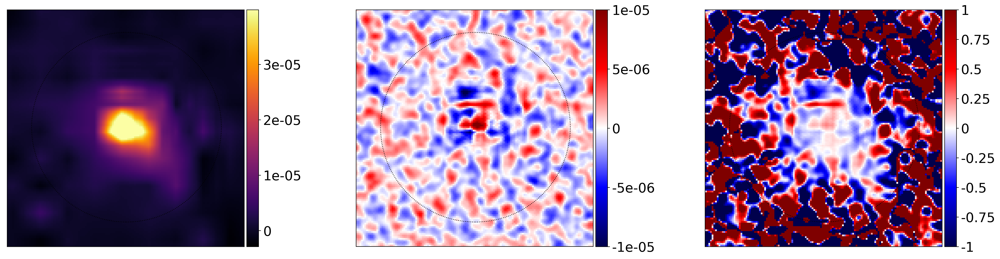

packet_db3_4_0.80


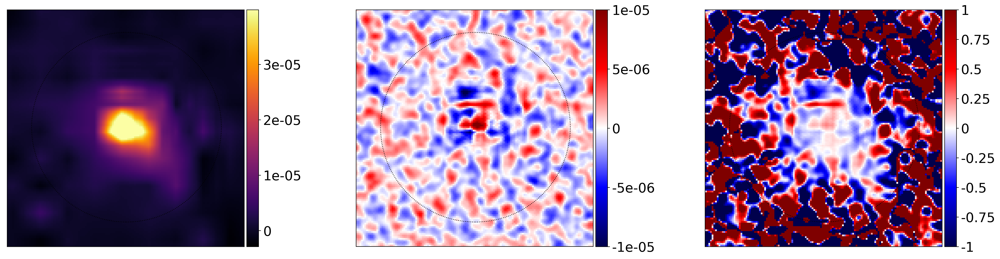

packet_db3_4_0.90


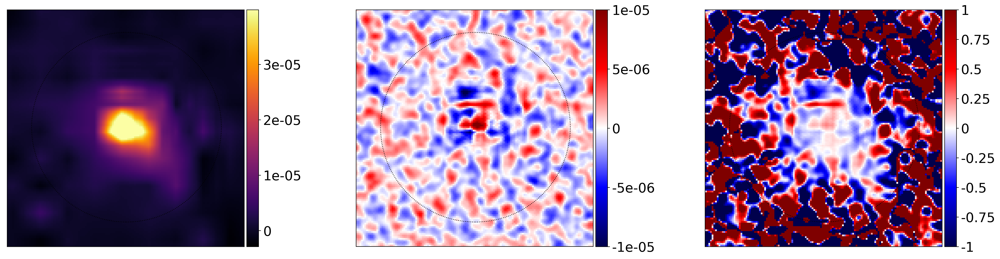

packet_db3_1_0.40


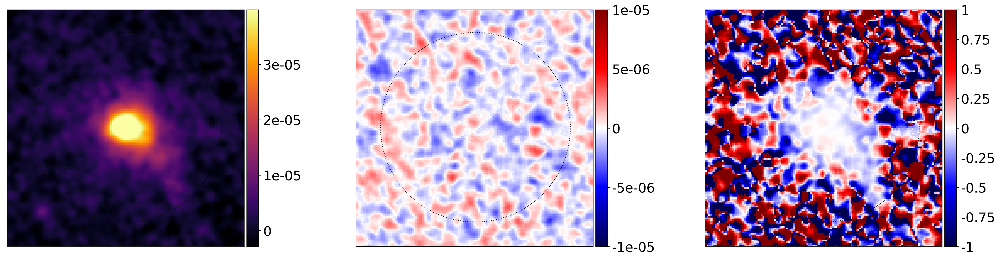

packet_db3_2_0.40


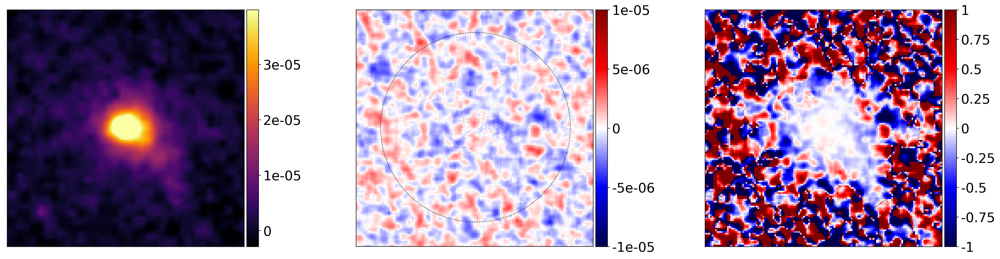

packet_db3_3_0.40


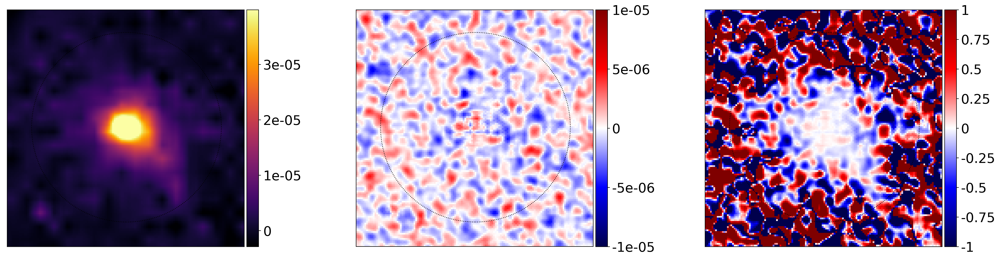

packet_db3_4_0.4


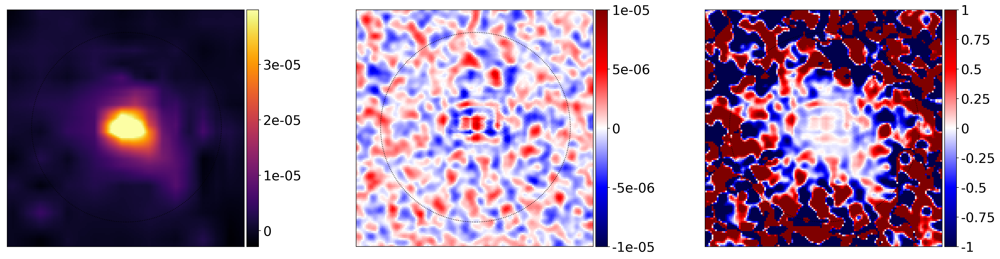

p_db3_4_0.40


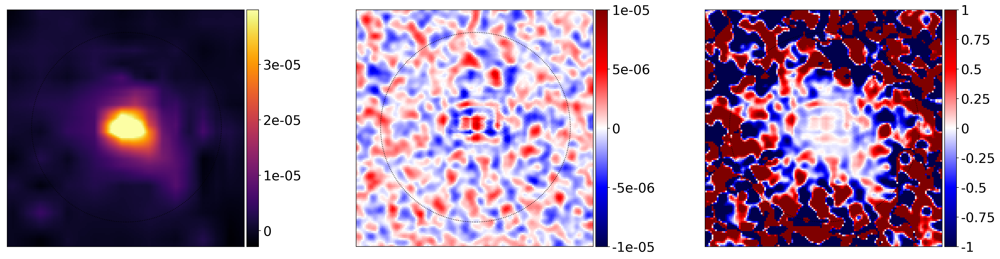

p_haar_4_0.40


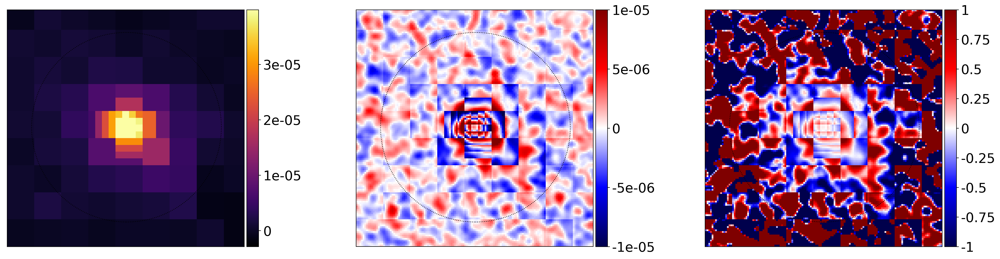

p_dmey_4_0.40


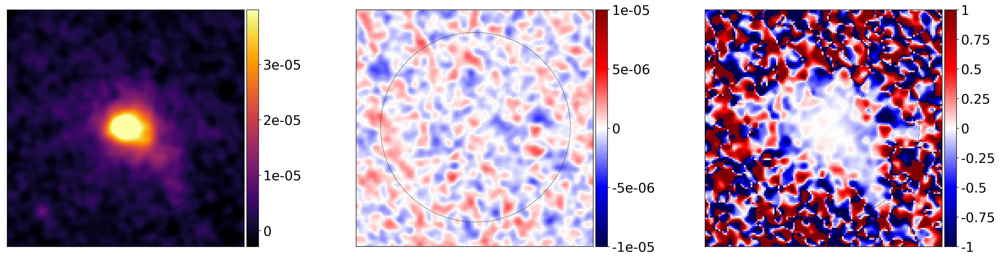

p_sym2_4_0.40


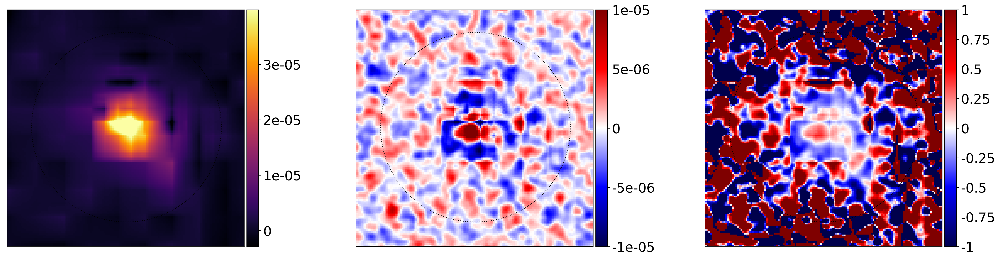

p_coif1_4_0.40


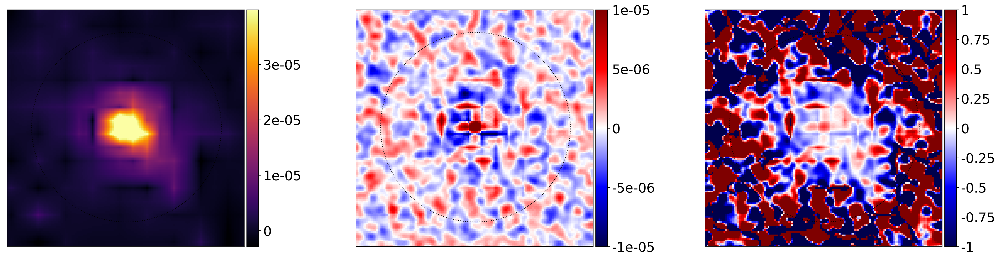

undec_bsplineatrous_7_1_0


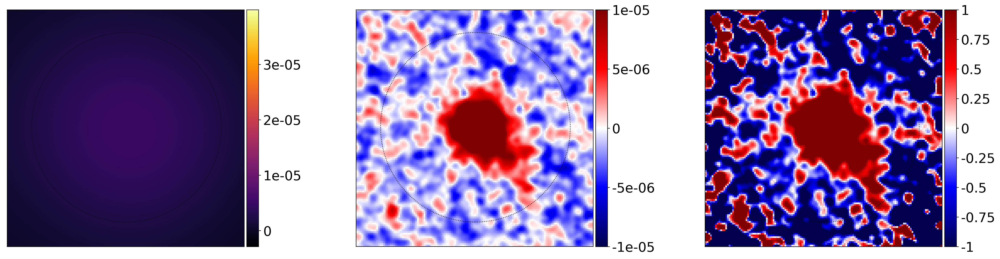

undec_bsplineatrous_7_2_0


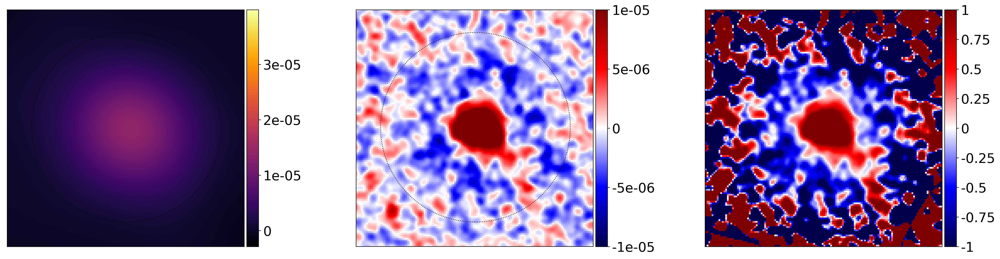

undec_bsplineatrous_7_3_0


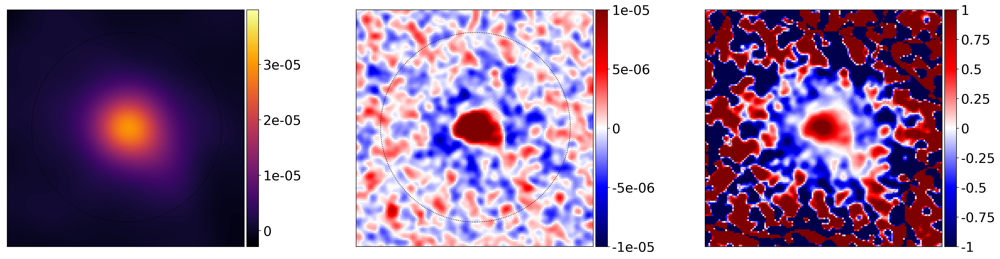

undec_bsplineatrous_7_4_0


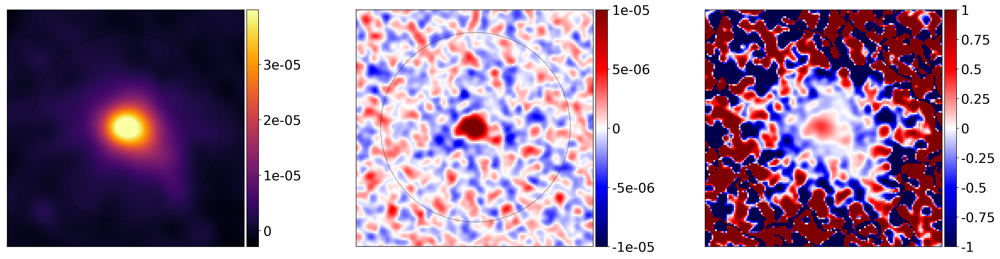

undec_bsplineatrous_7_5_0


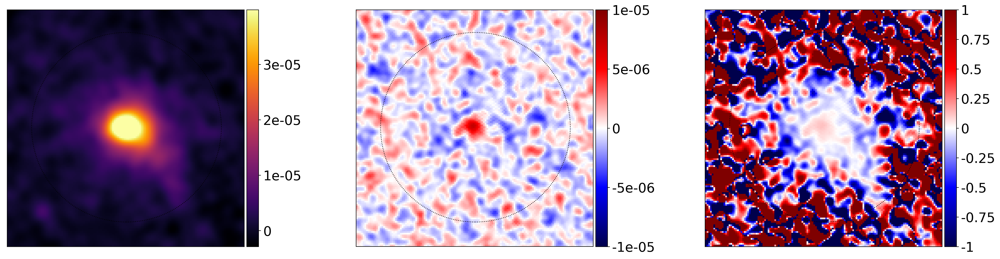

undec_bsplineatrous_7_6_0


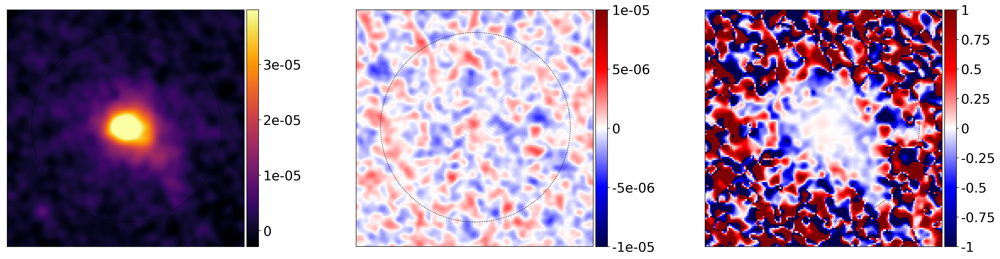

u_bsplineatrous_7_3_0


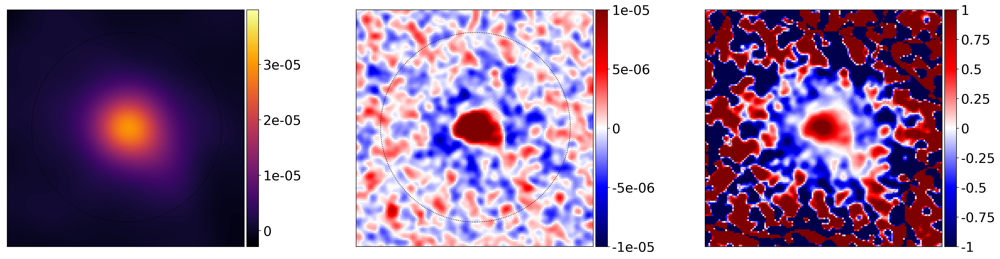

u_linearatrous_7_3_0


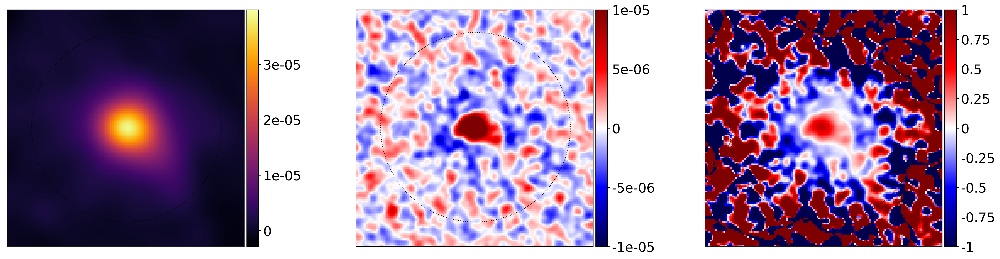

u_haaratrous_7_3_0


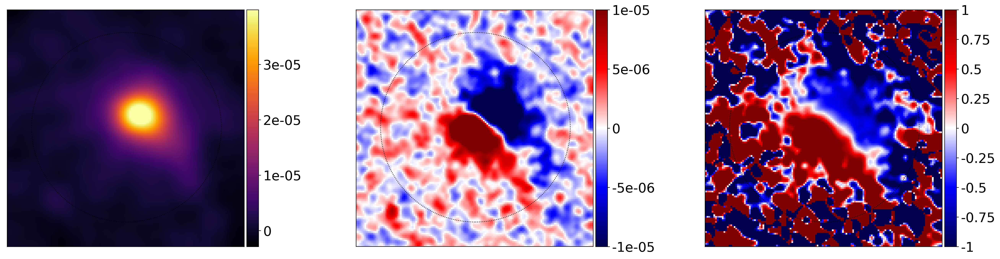

undecradial_bsplineatrous_7_1_0


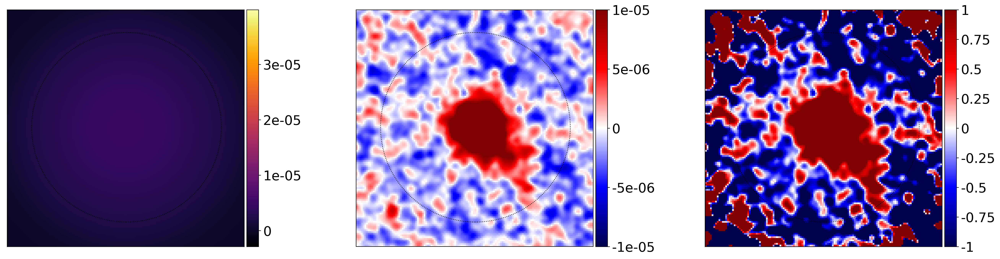

undecradial_bsplineatrous_7_2_0


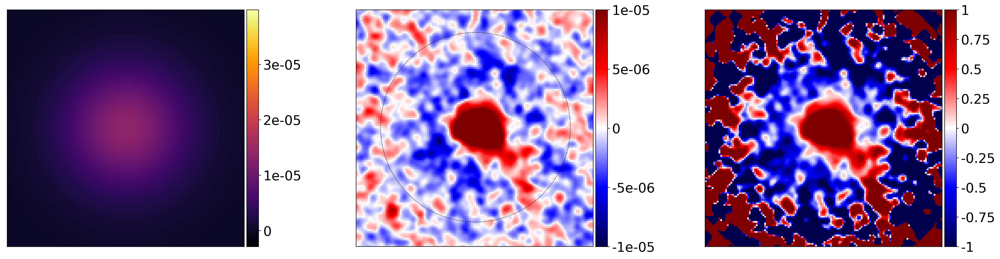

undecradial_bsplineatrous_7_3_0


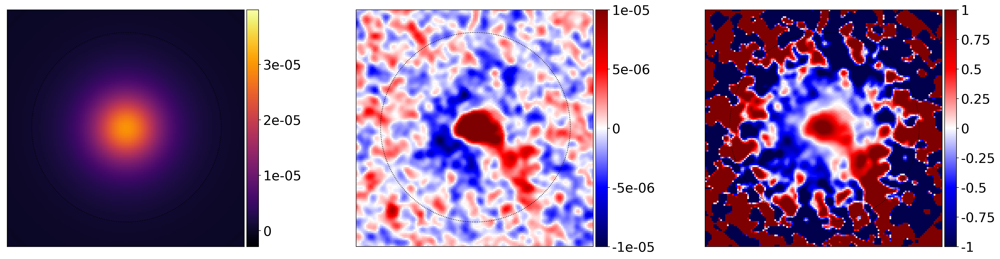

undecradial_bsplineatrous_7_4_0


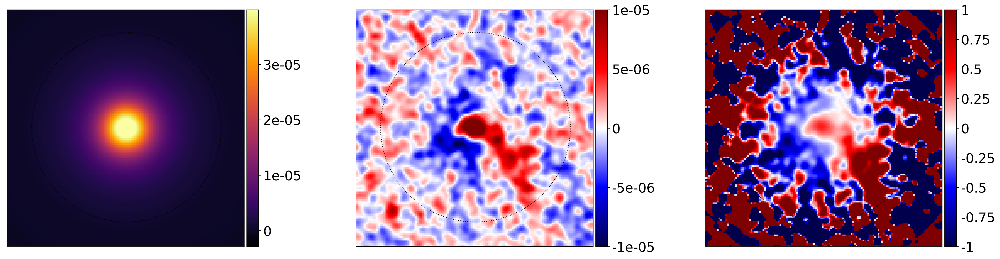

undecradial_bsplineatrous_7_5_0


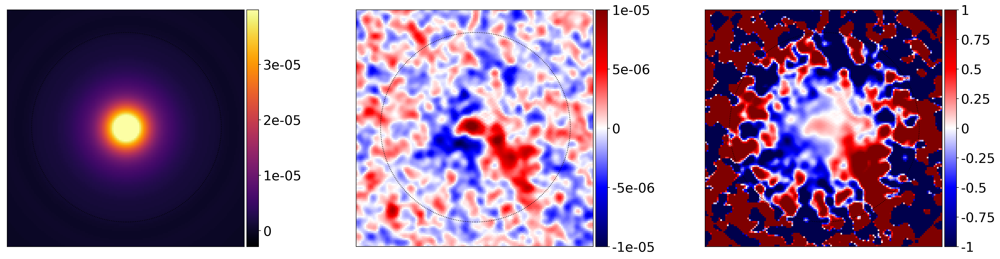

undecradial_bsplineatrous_7_6_0


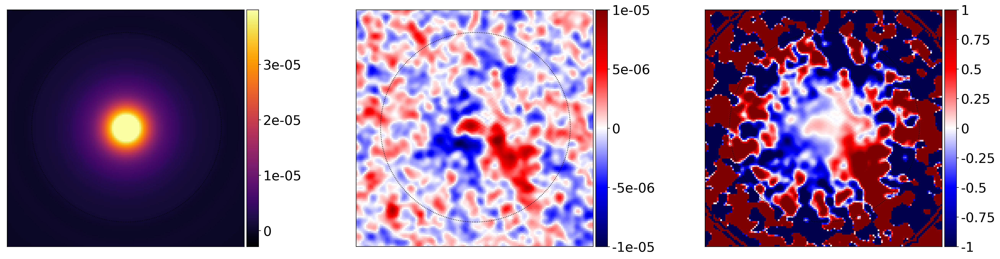

undecradial_bsplineatrous_7_7_0


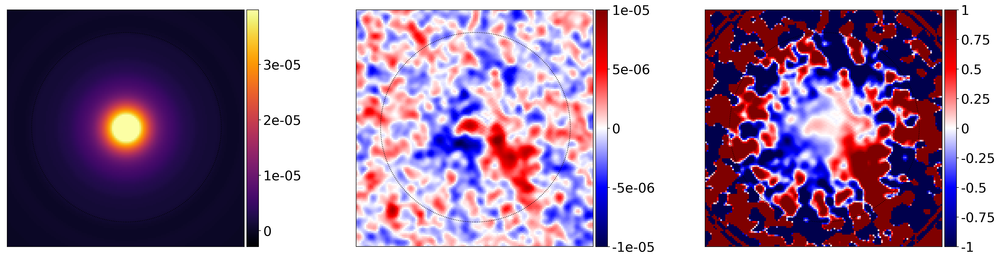

u_bsplineatrous_7_4_0


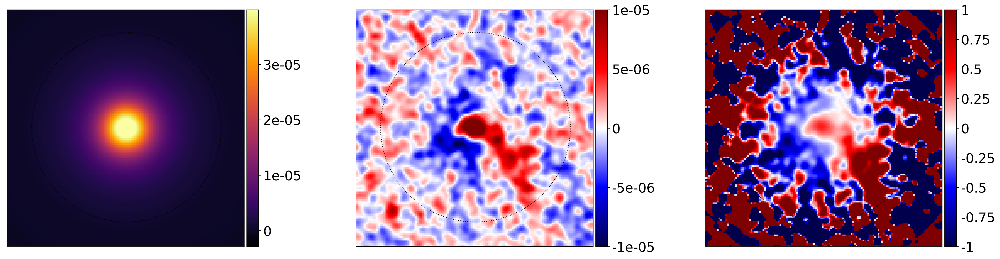

u_linearatrous_7_4_0


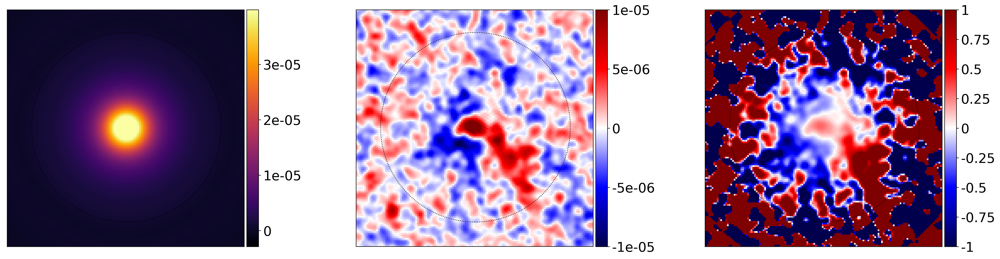

u_haaratrous_7_4_0


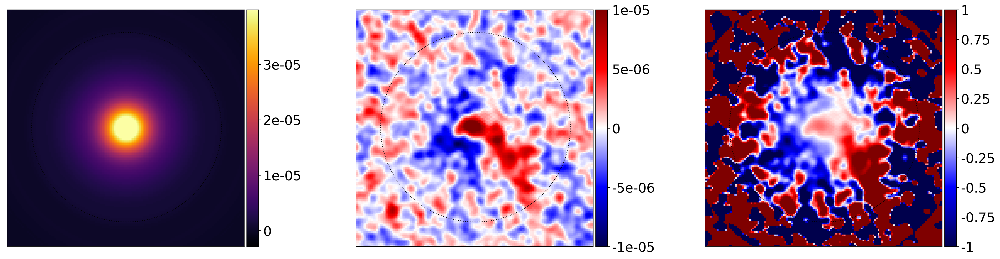

n1


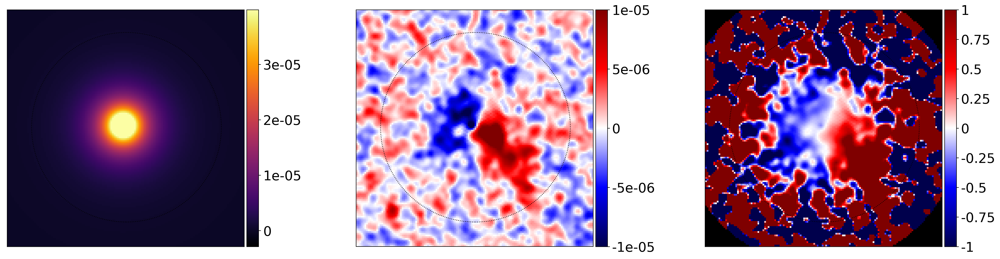

In [2]:
## FIRST MAKE THE SZ OBSERVATION
fsz = fits.open(SZ_DATA + 'map2048_MILCA_Coma_20deg_first.fits')
Ysz = fsz[1].data
# mysz = fits.open(SZ_DATA + 'map2048_MILCA_Coma_20deg_first.fits')
# msz = mysz[1].data

cpos = (Ysz.shape[0]//2, Ysz.shape[1]//2)
ss = 70
xmin, xmax = cpos[0]-ss, cpos[0]+ss
ymin, ymax = cpos[1]-ss, cpos[1]+ss

fwhm = 10.
sig = fwhm / np.sqrt(8. * np.log(2.))
# msz = arevalo_spectra.img_conv_gaussian(msz, sig)

#Ysz_cut, msz_cut = Ysz[xmin:xmax, ymin:ymax], msz[xmin:xmax, ymin:ymax]
#Ysz_cut, msz_cut = Ysz[xmin:xmax, ymin:ymax], inputsfirst['e1'][2]
#dsz = Ysz_cut - msz_cut

Ysz_cut, dsz, msz_cut = Ysz[xmin:xmax, ymin:ymax], inputsfirst['e1'][0], inputsfirst['e1'][2]

dsz_all = [inputsfirst['e1'][0], inputslast['e1'][0],(inputsfirst['e1'][0]+inputslast['e1'][0])/2]
norm_dsz_all = [inputsfirst['e1'][1], inputslast['e1'][1],(dsz_all[2])/ inputsfirst['e1'][2]]

## SZ DISTANCE
sz_deltdec = (fsz[1].header['CDELT2'] * u.deg).to(u.arcmin)
sz_distance_kpc = (sz_deltdec * d_A).to(u.kpc, u.dimensionless_angles())

sz_L = sz_distance_kpc.value * dsz.shape[0]
sz_L2 = [sz_L, sz_L]
sz_dx = sz_distance_kpc.value
print(sz_L, 'kpc', sz_dx, 'kpc/pixel')

## PLOT THE IMAGES
# fig, ax = plotting.get_fig((1, 3))

# cmin, cmax = plotting.get_symmetric_minmax(Ysz_cut)
# Ysz_ax_kwargs = {'origin': 'lower', 'interpolation': 'none', 'cmap': bwr_cmap, 'vmin': cmin, 'vmax': cmax}
# plotting.imshow_cbar(Ysz_cut, fig, ax[0], Ysz_ax_kwargs)

# cmin, cmax = plotting.get_symmetric_minmax(msz_cut, p=0.98, sym=False)
# msz_ax_kwargs = {'origin': 'lower', 'interpolation': 'none', 'cmap': inferno_cmap, 'vmin': cmin, 'vmax': cmax}
# #msz_ax_kwargs = {'origin': 'lower', 'interpolation': 'none', 'cmap': inferno_cmap, 'norm': LogNorm(vmin=cmin, vmax=cmax)}
# plotting.imshow_cbar(msz_cut, fig, ax[1], msz_ax_kwargs)

# cmin, cmax = plotting.get_symmetric_minmax(dsz)
# dsz_ax_kwargs = {'origin': 'lower', 'interpolation': 'none', 'cmap': bwr_cmap, 'vmin': cmin, 'vmax':cmax}
# plotting.imshow_cbar(dsz, fig, ax[2], dsz_ax_kwargs)

# for a in ax:
#     a.set_xticks([])
#     a.set_yticks([])

# fig.tight_layout()
# ax[0].set_title('Total, $y = y_0 + \delta y$')
# ax[1].set_title('Mean, $y_0$')
# ax[2].set_title('Fluctuations, $\delta y$')

# from matplotlib.patches import Circle
# R500 = (2.62*u.Mpc).to(u.kpc).value / sz_dx
# for a in ax:
#     circ = Circle([n//2 for n in Ysz_cut.shape], R500, color='black', linestyle=':', fill=False)
#     a.add_patch(circ)

## RMS
cmin_msz,cmax_msz = 0,0
cmin_dsz,cmax_dsz = 0,0
for k in inputsfirst.keys():
    rmsfirst = np.sqrt(np.mean(inputsfirst[k][0]**2))
    rmslast = np.sqrt(np.mean(inputslast[k][0]**2))
    rmsmooth = np.sqrt(np.mean(inputsfirst[k][2]**2))
    rmsymap = np.sqrt(np.mean(Ysz_cut**2))
    #round(rmsmooth/rmsymap*100,3)
    cmin_msz_temp, cmax_msz_temp = plotting.get_symmetric_minmax(inputsfirst[k][2], p=0.98, sym=False)
    cmin_dsz_temp, cmax_dsz_temp = plotting.get_symmetric_minmax(inputsfirst[k][0], p=0.98, sym=False)
    if cmin_msz_temp < cmin_msz:
        cmin_msz = cmin_msz_temp
    if cmin_dsz_temp < cmin_dsz:
        cmin_dsz = cmin_dsz_temp 
        
    if cmax_msz_temp > cmax_msz:
        cmax_msz = cmax_msz_temp
    if cmax_dsz_temp > cmax_dsz:
        cmax_dsz = cmax_dsz_temp 
    print(k, rmsfirst, round(rmsfirst/rmsymap*100,3), round(rmsmooth/rmsymap*100,3), sep='\t')

msz_all_comp = {}
dsz_all_comp = {}
nsz_all_comp = {}

for k in inputsfirst.keys():
    dsz_all_comp[k] = [inputsfirst[k][0], inputslast[k][0], (inputsfirst[k][0] + inputslast[k][0])/2]
    msz_all_comp[k] = [inputsfirst[k][2]]
    nsz_all_comp[k] = [inputsfirst[k][1], inputslast[k][1], (inputsfirst[k][1] + inputslast[k][1])/2]

    fig, ax = plotting.get_fig((1, 3))
    cbar_kwargs = {'size': '5%', 'pad': 0.05}
    cmin, cmax = plotting.get_symmetric_minmax(msz_all_comp[k], p=0.98, sym=False)
    msz_ax_kwargs = {'origin': 'lower', 'interpolation': 'none', 'cmap': inferno_cmap, 'vmin': cmin_msz, 'vmax': cmax_msz}
    #msz_ax_kwargs = {'origin': 'lower', 'interpolation': 'none', 'cmap': inferno_cmap, 'norm': LogNorm(vmin=cmin, vmax=cmax)}
    plotting.imshow_cbar(msz_all_comp[k][0], fig, ax[0], msz_ax_kwargs, cbar_kwargs, fontsize=20, format = '%g')

    cmin, cmax = plotting.get_symmetric_minmax(dsz_all_comp[k])
    cmin,cmax = -1e-5,1e-5
    dsz_ax_kwargs = {'origin': 'lower', 'interpolation': 'none', 'cmap': bwr_cmap, 'vmin': cmin, 'vmax':cmax}
    plotting.imshow_cbar(dsz_all_comp[k][0], fig, ax[1], dsz_ax_kwargs,fontsize=20, format = '%g')

    cmin, cmax = plotting.get_symmetric_minmax(nsz_all_comp[k])
    cmin, cmax = -1,1
    nsz_ax_kwargs = {'origin': 'lower', 'interpolation': 'none', 'cmap': bwr_cmap, 'vmin': cmin, 'vmax':cmax}
    plotting.imshow_cbar(nsz_all_comp[k][0], fig, ax[2], nsz_ax_kwargs,fontsize=20, format = '%g')


    for a in ax:
        a.set_xticks([])
        a.set_yticks([])
    print(k)
    fig.tight_layout()


    from matplotlib.patches import Circle
    R500 = (2.62*u.Mpc).to(u.kpc).value / sz_dx
    for a in ax:
        circ = Circle([n//2 for n in Ysz_cut.shape], R500, color='black', linestyle=':', fill=False)
        a.add_patch(circ)
    plt.savefig("images/notebookimages/sfn/smoothflucnorm_" + k + ".png")
    plt.show()
    plt.close()

In [ ]:
deltra = (fsz[1].header['CDELT1'] * u.deg).to(u.arcmin)
deltdec = (fsz[1].header['CDELT2'] * u.deg).to(u.arcmin)
# This matches Khatri
print(deltdec, (deltdec * dsz.shape[0]).to(u.deg))

d_A = cosmo.angular_diameter_distance(z=COMA_REDSHIFT)
theta = deltdec * dsz.shape[0]
distance_kpc = (theta * d_A).to(u.kpc, u.dimensionless_angles())
print(distance_kpc, theta.to(u.arcsec))

Lkpc = distance_kpc
Larcsec = (theta.to(u.arcsec))
print("rad patch",)
Lcunit = Lkpc.unit
Lc = Lkpc.value

L = [Lc, Lc]
print(L)

In [ ]:
#Mask
def makemask(cr = 60, theta_ap = 15, infalling=False):
    # cr = radius of mask in arcmin
    # theta_ap = apodization scale in arcmin
    Nx, Ny = np.shape(Ysz_cut)[0], np.shape(Ysz_cut)[0]
    mask = np.zeros((Nx, Ny))
    cen_x, cen_y = Nx / 2., Ny / 2.

    I, J = np.meshgrid(np.arange(mask.shape[0]), np.arange(mask.shape[1]))
    dist = np.sqrt((I - cen_x) ** 2 + (J - cen_y) ** 2)
    dist = dist * deltdec.value
    idx = np.where(dist <= cr)

    mask[idx] = 1 - np.exp(-9 * (dist[idx] - cr) ** 2 / (2 * theta_ap ** 2))  # described in Khatri et al.
    if infalling:
        startx,starty = 0,70
        lenx, leny = 70,70
        mask[startx:startx+lenx, starty:starty+leny] = 0
    return mask

mask = makemask(infalling=True)
f0 = nmt.NmtFieldFlat(L[0], L[1], mask, [dsz_all[0]])
plt.imshow(f0.get_maps()[0] * mask, interpolation='nearest', origin='lower')
plt.colorbar()

In [ ]:
def k_to_l(x):
    return 1./x
def l_to_k(x):
    return 1./x

colors = cmr.take_cmap_colors('cmr.ocean', 4, cmap_range=(0.15, 0.85), return_fmt='hex')

NBINS = 6
IG_NAN = True
SPEC_TYPE = 'modal'
dkhatri = np.diff(khatrix)/2.
minb, maxb = khatrix[0]-dkhatri[0]-1.2e-4, khatrix[-1]+dkhatri[-1]
LOG_SPACE = True
HALF_BIN = None
#minb, maxb =None, None

N = np.shape(Ysz_cut)[0]
mask = makemask()
datafirst = dsz_all[0]
datalast = dsz_all[1]
fig, ax = plotting.get_fig((1, 1))
ax.set_xscale('log')
ax.set_ylabel('Amplitude spectrum, $A_{\\delta y}(k_\\theta) = (k^2P_{\delta y}(k)/(2\pi))^{1/2} (10^{-6})$')

#Cross base
k3_c, fek3_c = per_spectra.modal_spectrum(datafirst, datalast, lenn=L)
fek3_c = np.abs(fek3_c)
kc, fekc, stc = spectra_base.spectrum_integrate(k3_c, fek3_c, spec_type=SPEC_TYPE, lenn=L, log_space=LOG_SPACE, num_bins=NBINS, ignore_nan=IG_NAN, min_bin=minb, max_bin=maxb)
ampc = abs((kc ** 2) * fekc / (2 * np.pi)) ** (1 / 2)
#ax.plot(kc/(2*np.pi), np.abs(ampc), marker='.', color=plotting.CB_color_cycle[3], label='Cross', zorder=4)

#Flatsky
k1, fek1,std1 = flatsky_spectra.modal_spectrum(datafirst, ar2=datalast, lenn=L, min_bin=minb, max_bin=maxb, log_space=LOG_SPACE, nbins=NBINS, max_half_bin_width=HALF_BIN)
amp1 = abs((k1 ** 2) * fek1 / (2 * np.pi)) ** (1 / 2)
ax.plot(k1/(2*np.pi), np.abs(amp1*1e6), marker='.', color=colors[3], label='Flatsky', zorder=5, linestyle='--')

#Arevalo
lags = arevalo_spectra.k_to_discrete_lags(k1, N, L=L[0])
k2, fek2 = arevalo_spectra.modal_spectrum(datafirst, ar2=datalast, lenn=L, lags=lags)
amp2 = abs((k2**2) * fek2 / (2. * np.pi))**(1./2.)
ax.plot(k2/(2*np.pi), np.abs(amp2*1e6), marker='.', color=colors[3], label='Arevalo', zorder=6)

#old periodogram code you did
k3_3, fek3_3 = per_spectra.modal_spectrum(datafirst*mask, ar2=datalast*mask, lenn=L)
k3, fek3, _ = spectra_base.spectrum_integrate(k3_3, fek3_3, lenn=L, log_space=LOG_SPACE, num_bins=NBINS, ignore_nan=IG_NAN, min_bin=minb, max_bin=maxb)
amp3 = abs((k3 ** 2) * fek3 / (2 * np.pi)) ** (1 / 2)
#ax.plot(k3/(2*np.pi), np.abs(amp3), marker='.', color=plotting.CB_color_cycle[6], label='P Mask', zorder=7, linestyle=':')                               

#Flatsky Mask
k4, fek4,std4 = flatsky_spectra.modal_spectrum(datafirst, ar2=datalast, lenn=L, mask=mask, min_bin=minb, max_bin=maxb, log_space=LOG_SPACE, nbins=NBINS,max_half_bin_width=HALF_BIN)
amp4 = abs((k4 ** 2) * fek4 / (2 * np.pi)) ** (1 / 2)
ax.plot(k4/(2*np.pi), np.abs(amp4*1e6), marker='.', color=colors[1], label='Flatsky mask', zorder=8, linestyle='--')
astd4 =  0.5 * k4**2 / (2. * np.pi) / amp4 * std4
astd4 =  0.5 / amp4 * std4
#ax.errorbar(k4/(2*np.pi), np.abs(amp4), astd4, marker='.', color=plotting.CB_color_cycle[7], label='Flatsky w/ mask', zorder=3)

#Arevalo Mask
k5, fek5 = arevalo_spectra.modal_spectrum(datafirst*mask, ar2=datalast*mask, exp1=mask, exp2=mask, lenn=L, lags=lags)
amp5 = abs((k5**2) * fek5 / (2. * np.pi))**(1./2.)
ax.plot(k5/(2*np.pi), np.abs(amp5)*1e6, marker='.', color=colors[1], label='Arevalo mask', zorder=9)



mask = makemask(infalling=True)

#Flatsky Masked infalling
k4, fek4,std4 = flatsky_spectra.modal_spectrum(datafirst, ar2=datalast, lenn=L, mask=mask, min_bin=minb, max_bin=maxb, log_space=LOG_SPACE, nbins=NBINS,max_half_bin_width=HALF_BIN)
amp4 = abs((k4 ** 2) * fek4 / (2 * np.pi)) ** (1 / 2)
ax.plot(k4/(2*np.pi), np.abs(amp4*1e6), marker='.', color=colors[2], label='Flatsky mask (w/o infalling group)', zorder=8, linestyle='--')
astd4 =  0.5 * k4**2 / (2. * np.pi) / amp4 * std4
astd4 =  0.5 / amp4 * std4
#ax.errorbar(k4/(2*np.pi), np.abs(amp4), astd4, marker='.', color=plotting.CB_color_cycle[7], label='Flatsky w/ mask', zorder=3)

#Arevalo Masked infalling
k5, fek5 = arevalo_spectra.modal_spectrum(datafirst*mask, ar2=datalast*mask, exp1=mask, exp2=mask, lenn=L, lags=lags)
amp5 = abs((k5**2) * fek5 / (2. * np.pi))**(1./2.)
ax.plot(k5/(2*np.pi), np.abs(amp5)*1e6, marker='.', color=colors[2], label='Arevalo mask (w/o infalling group)', zorder=9)



#Kolm
k_kol = np.linspace(np.min(kc), np.max(kc), num=1000)
#ax.plot(k_kol/(2*np.pi), 2e-5*k_kol**(-1./3.), linestyle=':', color='black', label='Kolmogorov', zorder=10)

#Khatri
plt.errorbar(khatrixk, np.array(khatriy)*1e6, yerr=(np.array(khatrierror)*1e6), fmt='kx',ecolor='black',elinewidth=1,capsize = 4)

ax.legend()
#ax.set_xlabel('Wavenumber, $k$ [$2\pi$/%s]' % Lcunit)
ax.set_xlabel('Wavenumber, $k/2\pi$ [$1$/%s]' % Lcunit)
fig.subplots_adjust(wspace=0.)

# inbetween scales 2000kpc - 500kpc
#ax.axvline(khatrixk[0], linestyle=':', color='gray', alpha=0.7)
#ax.axvline(khatrixk[-1], linestyle=':', color='gray', alpha=0.7)

#ax.axvline(l_to_k(500.), linestyle=':', color='gray', alpha=0.7)
#ax.axvline(l_to_k(2000.), linestyle=':', color='gray', alpha=0.7)

ax2 = ax.secondary_xaxis('top', functions=(k_to_l, l_to_k))
ax2.set_xlabel('Length scale, $\lambda$ [%s]' % Lcunit)


In [ ]:
chandra7x = (0.002239405, 0.00271172, 0.003283653, 0.003968125, 0.004805047, 0.005818485, 0.007045668, 0.008531679, 0.010331105, 0.012484607, 0.015117751, 0.018306253, 0.022167247, 0.026842567)
chandra7y = (0.090540607, 0.12303037, 0.15136472, 0.168130827, 0.171019496, 0.16112082, 0.144232418, 0.128383146, 0.11623888, 0.107661193, 0.101718108, 0.096376335, 0.091056194, 0.086519634)
chandra7error = [[0.017985858, 0.02044217, 0.026220555, 0.020584891, 0.017490684, 0.015241051, 0.011776455, 0.0067421, 0.005162252, 0.003310416, 0.003127676, 0.003228265, 0.002548905, 0.00337159],
                 [0.015603028, 0.021202048, 0.023583685, 0.020220712, 0.018404618, 0.016833387, 0.012823481, 0.00866339, 0.004028532, 0.002786487, 0.003226898, 0.003340148, 0.002622311, 0.002491663]]

khatri60x = (0.00046039433747438474, 0.0005632006274510132, 0.0007161361203245386, 0.0009738806728474981, 0.001332503734963524, 0.001845593970498064)
khatri60y = (0.3043363895298042, 0.38850428002577697, 0.5073434947892992, 0.6550526414189785, 0.7635907624057583, 0.8314804348799094)
khatri60error = [[0.042516602, 0.05332479, 0.072114688, 0.099456071, 0.135849729, 0.233318542],
                 [0.042459533, 0.055460943, 0.070782097, 0.097774794, 0.139248334, 0.229955919]]

khatri40x = (0.000694597, 0.000847973, 0.001078237, 0.001469294, 0.00200218)
khatri40y = (0.336132481, 0.414720838, 0.505905092, 0.617137937, 0.735920791)
khatri40error = [[0.068297788, 0.080491637, 0.098189253, 0.125394475, 0.18815573],
                 [0.06469668, 0.074238229, 0.097373451, 0.127188176, 0.20352775]]

khatri20x = (0.00138224, 0.001701254, 0.002154435)
khatri20y = (0.269359888, 0.330454908, 0.454164639)
khatri20error = [[0.078857091, 0.099382304, 0.150691093],
                [0.078422054, 0.103539952, 0.149113905]]
planck_fwhm_kpc = 10. * sz_dx / deltdec.value     #arcmin * kpc/pix / (arcmin/pix) = kpc
colors = cmr.take_cmap_colors('cmr.ocean', 2, cmap_range=(0.15, 0.85), return_fmt='hex')
#Khatri equation 9: P_p(k) = P_y(k) /  N(\theta)
#Further assumption for fig 11: N(\theta) = 7e-4
Ntheta =  7e-4

#Norm_y_fluc (Arevalo Mask)
normk, normfek = arevalo_spectra.modal_spectrum(norm_dsz_all[0]*mask, ar2=norm_dsz_all[1]*mask, exp1=mask, exp2=mask, lenn=L, lags=lags)
normpp = normfek / Ntheta
normampp = abs((normk**3) * normpp / (2. * np.pi**2))**(1./2.)
normamppea,normkea = normampp,normk

#norm_y_fluc (Flatsky Mask)
normk1, normfek1, normstd1 = flatsky_spectra.modal_spectrum(norm_dsz_all[0], ar2=norm_dsz_all[1], lenn=L, mask=mask, min_bin=minb, max_bin=maxb, log_space=False, nbins=NBINS)
normpp1 = normfek1 / Ntheta
normampp1 = abs((normk1**3) * normpp1 / (2. * np.pi**2))**(1./2.)


#normyfluc (old periodogram)
normk2_3, normfek2_3 = per_spectra.modal_spectrum(norm_dsz_all[0]*mask, ar2=norm_dsz_all[1]*mask, lenn=L)
normk2, normfek2, _ = spectra_base.spectrum_integrate(normk2_3, normfek2_3, spec_type='modal', lenn=L, bin_center=True)
normpp2 = normfek2 / Ntheta
normampp2 = abs((normk2**3) * normpp2 / (2. * np.pi**2))**(1./2.)
                            

fig, ax = plotting.get_fig((1, 1))
ax.set_xlabel('Wavenumber, $k/2\pi$ = $1/\lambda$')
ax.set_ylabel("$A_{P} = (k^3P_{P}(k)/(2\pi^2))^{1/2}$")
ax.set_xscale('log')
ax.set_yscale('log')

plt.errorbar(khatri60x, khatri60y, yerr=(khatri60error), fmt='kx',ecolor='black',elinewidth=1,capsize = 4,label='60 KG16')
plt.errorbar(khatri40x, khatri40y, yerr=(khatri40error), fmt='kx',ecolor='grey',elinewidth=1,capsize = 4,label='40 KG16')
plt.errorbar(khatri20x, khatri20y, yerr=(khatri20error), fmt='kx',ecolor='lightgrey',elinewidth=1,capsize = 4,label='20 KG16')

plt.errorbar(chandra7x, chandra7y, yerr=(chandra7error), linestyle='', marker='x', fmt='purple',ecolor='purple',elinewidth=1,capsize = 4,label='Chandra')

ax.plot(normk/(2*np.pi), np.abs(normampp), marker='.', color=colors[0], label='60 arevalo ellipse', zorder=9)
ax.plot(normk1/(2*np.pi), np.abs(normampp1), marker='.', color=colors[0], label='60 Flatsky', zorder=8, linestyle=':')
#ax.plot(normk2/(2*np.pi), np.abs(normampp2), marker='.', color=plotting.CB_color_cycle[6], label='60 P Mask', zorder=7)   


plt.axvline(x = 1/planck_fwhm_kpc, color = 'grey', linestyle=':', label = 'Planck FWHM')
ax.legend()

In [ ]:
NBINS = 6
IG_NAN = True
SPEC_TYPE = 'modal'
dkhatri = np.diff(khatrix)/2.
minb, maxb = khatrix[0]-dkhatri[0]-1.2e-4, khatrix[-1]+dkhatri[-1]
LOG_SPACE = True
HALF_BIN = None
N = np.shape(Ysz_cut)[0]
mask = makemask()
from params import groups


for g in groups:
    fig, ax = plotting.get_fig((1, 1))
    ax.set_xscale('log')
    ax.set_ylabel('Amplitude spectrum, $A_{\\delta y}(k_\\theta) = (k^2P_{\delta y}(k)/(2\pi))^{1/2} (10^{-6})$')
    colour = 0
    colors = cmr.take_cmap_colors('cmr.ocean', len(g), cmap_range=(0.15, 0.80), return_fmt='hex')
    key = None
    for k in g.keys():
            datafirst = dsz_all_comp[k][0]
            datalast = dsz_all_comp[k][1]
            if key == None:
                key = k
            #Flatsky Mask
            k4, fek4,std4 = flatsky_spectra.modal_spectrum(datafirst, ar2=datalast, lenn=L, mask=mask, min_bin=minb, max_bin=maxb, log_space=LOG_SPACE, nbins=NBINS,max_half_bin_width=HALF_BIN)
            amp4 = abs((k4 ** 2) * fek4 / (2 * np.pi)) ** (1 / 2)
            ax.plot(k4/(2*np.pi), np.abs(amp4)*1e6, marker='.', color=colors[colour], zorder=8, linestyle='--')

            #Arevalo Mask
            lags = arevalo_spectra.k_to_discrete_lags(k4, N, L=L[0])
            k5, fek5 = arevalo_spectra.modal_spectrum(datafirst*mask, ar2=datalast*mask, exp1=mask, exp2=mask, lenn=L, lags=lags)
            amp5 = abs((k5**2) * fek5 / (2. * np.pi))**(1./2.)
            ax.plot(k5/(2*np.pi), np.abs(amp5)*1e6, marker='.', color=colors[colour], zorder=9)
            ax.plot([], [], color=colors[colour], label=k)
            colour += 1
        
    #Khatri
    plt.errorbar(khatrixk, np.array(khatriy)*1e6, yerr=(np.array(khatrierror)*1e6), fmt='kx',ecolor='black',elinewidth=1,capsize = 4)

    ax.legend()
    ax.set_xlabel('Wavenumber, $k/2\pi$ [$1$/%s]' % Lcunit)
    fig.subplots_adjust(wspace=0.)
    ax2 = ax.secondary_xaxis('top', functions=(k_to_l, l_to_k))
    ax2.set_xlabel('Length scale, $\lambda$ [%s]' % Lcunit)
    #plt.savefig("images/notebookimages/powerspec/amplitude_group_" + k + ".png")

In [ ]:
norm_dsz_all_comp = {}
normoutputs = {}
colour = 0
from params import groups

groupnumber = 0
for g in groups:
    fig, ax = plotting.get_fig((1, 1))
    ax.set_xlabel('Wavenumber, $k/2\pi$ = $1/\lambda$')
    ax.set_ylabel("$A_{P} = (k^3P_{P}(k)/(2\pi^2))^{1/2}$")
    ax.set_xscale('log')
    ax.set_yscale('log')
    colour = 0
    colors = cmr.take_cmap_colors('cmr.ocean', len(g), cmap_range=(0.15, 0.85), return_fmt='hex')
    #color=plotting.cbf_cols[colour]
    
    key = None
    for k in g.keys():
            norm_dsz_all_comp[k] = [inputsfirst[k][1], inputslast[k][1], (inputsfirst[k][0] - inputslast[k][0])/ 2* inputsfirst[k][2]]
            if key == None:
                key = k
            #Norm_y_fluc (Arevalo Mask)
            normk, normfek = arevalo_spectra.modal_spectrum(norm_dsz_all_comp[k][0]*mask, ar2=norm_dsz_all_comp[k][1]*mask, exp1=mask, exp2=mask, lenn=L, lags=lags)
            normpp = normfek / Ntheta
            normampp = abs((normk**3) * normpp / (2. * np.pi**2))**(1./2.)
            normoutputs[k] = [normk,normpp,normampp]

            if groupnumber == 0:
                ax.plot(normoutputs[k][0]/(2*np.pi), np.abs(normoutputs[k][2]), marker='.', color=colors[colour], zorder=9, label='Ellipse')
            if groupnumber == 1:
                ax.plot(normoutputs[k][0]/(2*np.pi), np.abs(normoutputs[k][2]), marker='.', color=colors[colour], zorder=9, label='NFW')          
            if groupnumber == 2:
                ax.plot(normoutputs[k][0]/(2*np.pi), np.abs(normoutputs[k][2]), marker='.', color=colors[colour], zorder=9, label=k[1:])
            if groupnumber == 3 or groupnumber == 6:
                ax.plot(normoutputs[k][0]/(2*np.pi), np.abs(normoutputs[k][2]), marker='.', color=colors[colour], zorder=9, label=k[-4:])
            if groupnumber == 4 or groupnumber == 7:
                if groupnumber == 7 and colour ==3:
                    ax.plot([], [], color=colors[colour], label='4')
                ax.plot(normoutputs[k][0]/(2*np.pi), np.abs(normoutputs[k][2]), marker='.', color=colors[colour], zorder=9, label=k[-6])
            if groupnumber == 5 or groupnumber == 8 or groupnumber == 10 or groupnumber == 12:
                ax.plot(normoutputs[k][0]/(2*np.pi), np.abs(normoutputs[k][2]), marker='.', color=colors[colour], zorder=9, label=k[2:])
            if groupnumber == 9 or groupnumber == 11:
                ax.plot(normoutputs[k][0]/(2*np.pi), np.abs(normoutputs[k][2]), marker='.', color=colors[colour], zorder=9, label=k[-3])
            colour += 1

    plt.errorbar(khatri60x, khatri60y, yerr=(khatri60error), fmt='kx',ecolor='black',elinewidth=1,capsize = 4,label='60 KG16')
    plt.errorbar(khatri40x, khatri40y, yerr=(khatri40error), fmt='kx',ecolor='grey',elinewidth=1,capsize = 4,label='40 KG16')
    plt.errorbar(khatri20x, khatri20y, yerr=(khatri20error), fmt='kx',ecolor='lightgrey',elinewidth=1,capsize = 4,label='20 KG16')

    plt.errorbar(chandra7x, chandra7y, yerr=(chandra7error), linestyle='', marker='x', fmt='purple',ecolor='purple',elinewidth=1,capsize = 4,label='Chandra')

    planck_fwhm_kpc = 10. * sz_dx / deltdec.value     #arcmin * kpc/pix / (arcmin/pix) = kpc
    plt.axvline(x = 1/planck_fwhm_kpc, color = 'grey', linestyle=':', label = 'Planck FWHM')
    ax.legend(fontsize="8" )
    groupnumber += 1
    
    #plt.savefig("images/notebookimages/pressure/pressure_group_" + key + ".png")

In [ ]:
import Functions

In [ ]:
#Functions.plot_wavelet_undec(Ysz_cut,8,data_g=Ysz_cut)

In [ ]:
NBINS = 6
IG_NAN = True
SPEC_TYPE = 'modal'
dkhatri = np.diff(khatrix)/2.
minb, maxb = khatrix[0]-dkhatri[0]-1.2e-4, khatrix[-1]+dkhatri[-1]
LOG_SPACE = True
HALF_BIN = None
N = np.shape(Ysz_cut)[0]
mask = makemask()
from params import groups

fig, ax = plotting.get_fig((1, 1))
ax.set_xscale('log')
ax.set_ylabel('Amplitude spectrum, $A_{\\delta y}(k_\\theta) = (k^2P_{\delta y}(k)/(2\pi))^{1/2} (10^{-6})$')
colour = 0
colors = cmr.take_cmap_colors('cmr.ocean', 2, cmap_range=(0.15, 0.80), return_fmt='hex')
key = None
for k in groups.keys():
    if k.startswith('e') or k.startswith('n'):
        datafirst = dsz_all_comp[k][0]
        datalast = dsz_all_comp[k][1]
        if key == None:
            key = k
        #Flatsky Mask
        k4, fek4,std4 = flatsky_spectra.modal_spectrum(datafirst, ar2=datalast, lenn=L, mask=mask, min_bin=minb, max_bin=maxb, log_space=LOG_SPACE, nbins=NBINS,max_half_bin_width=HALF_BIN)
        amp4 = abs((k4 ** 2) * fek4 / (2 * np.pi)) ** (1 / 2)
        ax.plot(k4/(2*np.pi), np.abs(amp4)*1e6, marker='.', color=colors[colour], zorder=8, linestyle='--')

        #Arevalo Mask
        lags = arevalo_spectra.k_to_discrete_lags(k4, N, L=L[0])
        k5, fek5 = arevalo_spectra.modal_spectrum(datafirst*mask, ar2=datalast*mask, exp1=mask, exp2=mask, lenn=L, lags=lags)
        amp5 = abs((k5**2) * fek5 / (2. * np.pi))**(1./2.)
        ax.plot(k5/(2*np.pi), np.abs(amp5)*1e6, marker='.', color=colors[colour], zorder=9)
        ax.plot([], [], color=colors[colour], label=k)
        colour += 1

#Khatri
plt.errorbar(khatrixk, np.array(khatriy)*1e6, yerr=(np.array(khatrierror)*1e6), fmt='kx',ecolor='black',elinewidth=1,capsize = 4)

ax.legend()
ax.set_xlabel('Wavenumber, $k/2\pi$ [$1$/%s]' % Lcunit)
fig.subplots_adjust(wspace=0.)
ax2 = ax.secondary_xaxis('top', functions=(k_to_l, l_to_k))
ax2.set_xlabel('Length scale, $\lambda$ [%s]' % Lcunit)
#plt.savefig("images/notebookimages/powerspec/amplitude_group_" + k + ".png")